<center><h1>Depth Estimation Experiment - DPT-Large - COCO dataset</h1>
<h2>Matthias Bartolo</h2>

</center>

Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution1.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


loading annotations into memory...
Done (t=8.47s)
creating index...
index created!


  0%|          | 4/25403 [00:00<1:40:31,  4.21it/s]


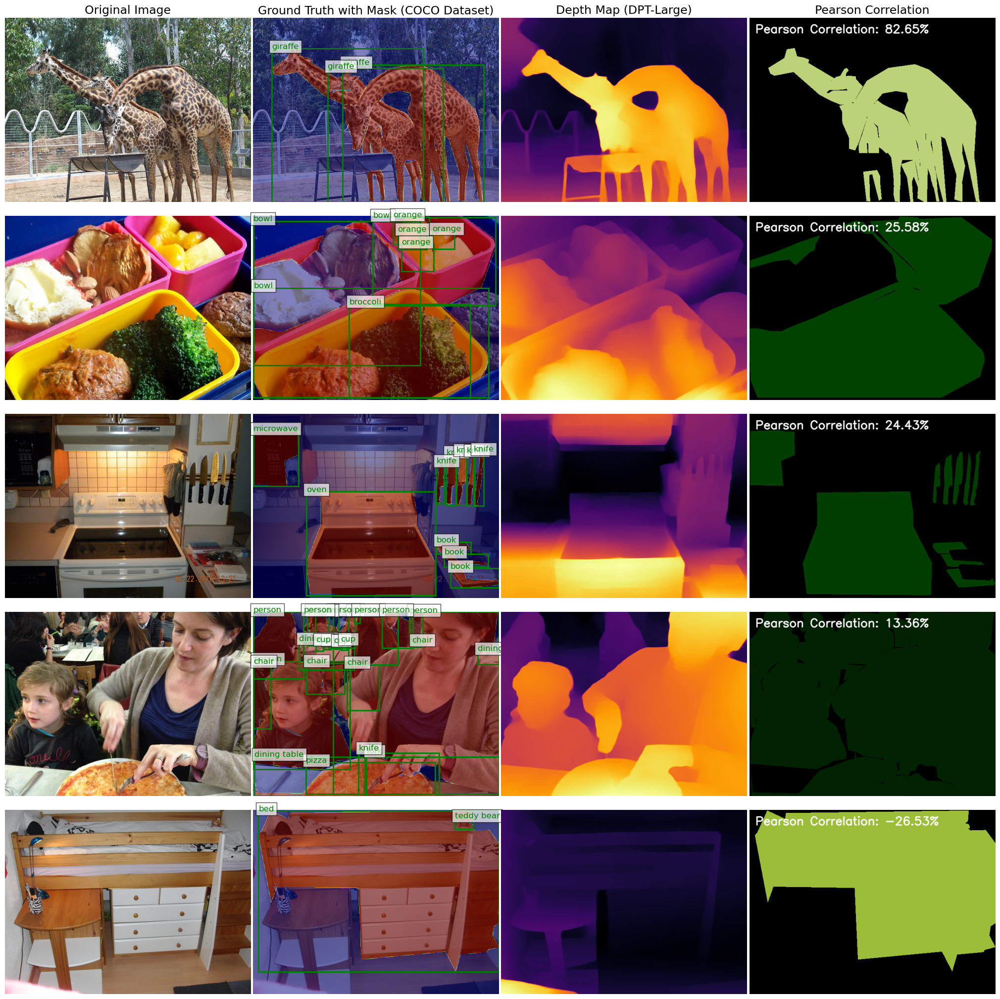

In [1]:
import os
from transformers import pipeline
from PIL import Image
import torch
import numpy as np
from pycocotools.coco import COCO
import cv2
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import matplotlib.patches as patches

coco_version = "2017"
data_type = "train"

# Path to the COCO annotation file
coco_annotation_file = f"COCODataset/annotations/instances_{data_type}{coco_version}.json"

# Folder containing COCO images
image_folder = f"COCODataset/{data_type}{coco_version}"

# Check if CUDA is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load depth estimation pipeline
pipe = pipeline(task="depth-estimation", model="Intel/dpt-large", device=device)

# Load COCO dataset and annotations
coco = COCO(coco_annotation_file)

# Function to extract object masks, bounding boxes, and category labels from the COCO dataset
def get_coco_masks_and_labels(image_id, coco):
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    
    mask = None
    bboxes = []
    categories = []
    
    for ann in annotations:
        if 'segmentation' in ann:
            segmentation = coco.annToMask(ann)
            if mask is None:
                mask = segmentation
            else:
                mask = np.maximum(mask, segmentation)
        
        if 'bbox' in ann:
            bboxes.append(ann['bbox'])  # Bounding box [x, y, width, height]
            category_id = ann['category_id']
            category_name = coco.loadCats(category_id)[0]['name']
            categories.append(category_name)
    
    return mask, bboxes, categories

# Function to process a single image and return results for grid display
def process_image(image_file):
    # Load image
    image_path = os.path.join(image_folder, image_file)
    image = Image.open(image_path)

    # Perform depth inference
    depth_map = pipe(image)["depth"]

    # Convert image filename to image_id (assuming COCO image naming convention)
    image_id = int(image_file.split('.')[0])

    # Get the object mask, bounding boxes, and category labels for the image from COCO annotations
    object_mask, bboxes, categories = get_coco_masks_and_labels(image_id, coco)

    if object_mask is None:
        return None

    # Resize mask to match the depth map dimensions
    depth_map_resized = cv2.resize(np.array(depth_map), (object_mask.shape[1], object_mask.shape[0]))

    # Flatten the object mask and depth map for Pearson correlation
    flattened_mask = object_mask.flatten()
    flattened_depth = depth_map_resized.flatten()

    # Pearson correlation between object mask and depth values
    correlation, _ = pearsonr(flattened_mask, flattened_depth)

    return image, object_mask, depth_map_resized, bboxes, categories, correlation

# Get list of image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Shuffle the image files and select 5 iamges with similar sizes
# np.random.shuffle(image_files)

# Pick the first image and then select images with similar sizes
image_file = image_files[0]
image_path = os.path.join(image_folder, image_file)
image = Image.open(image_path)
image_size = image.size

# Filter 5 images with similar sizes
image_files = [f for f in image_files if Image.open(os.path.join(image_folder, f)).size == image_size]

# Only process 5 images for demonstration purposes (Sample from the iamges, and choose images with similar sizes)
selected_images = []
for image_file in tqdm(image_files):
    result = process_image(image_file)
    if result is not None:
        selected_images.append(result)
    if len(selected_images) == 5:
        break

# Sort images based on Pearson correlation
selected_images = sorted(selected_images, key=lambda x: x[-1], reverse=True)

# Create a 5x4 grid of images
fig, axes = plt.subplots(5, 4, figsize=(20, 25))

# Define column titles
column_titles = [
    "Original Image",
    "Ground Truth with Mask (COCO Dataset)",
    "Depth Map (DPT-Large)",
    "Pearson Correlation"
]

# Set column titles
for col, title in enumerate(column_titles):
    axes[0, col].set_title(title, fontsize=17)

for i, (image, object_mask, depth_map, bboxes, categories, correlation) in enumerate(selected_images):
    row = i
    # Original Image
    axes[row, 0].imshow(image)
    axes[row, 0].axis("off")

    # Ground Truth with Mask and Labels
    ax = axes[row, 1]
    ax.imshow(image)
    ax.imshow(object_mask, cmap="jet", alpha=0.5)  # Overlay mask with color
    for bbox in bboxes:
        x, y, width, height = bbox
        rect = patches.Rectangle((x, y), width, height, linewidth=2, edgecolor='green', facecolor='none')
        ax.add_patch(rect)
    for j, bbox in enumerate(bboxes):
        x, y, width, height = bbox
        category = categories[j]
        ax.text(x, y, category, color='green', fontsize=12, bbox=dict(facecolor='white', alpha=0.7))
    ax.axis("off")

    # Depth Map
    axes[row, 2].imshow(depth_map, cmap="inferno")
    axes[row, 2].axis("off")

    # Pearson Correlation Heatmap
    correlation_map = np.zeros_like(object_mask, dtype=float)
    correlation_map[object_mask == 1] = correlation
    # Add to the correlation map white text with the correlation value
    percentage_text = f"Pearson Correlation: {correlation * 100:.2f}%"
    # Change the correlation map to RGB by truning it into a green ehatmap
    correlation_map_rgb = cv2.applyColorMap((correlation_map * 255).astype(np.uint8), cv2.COLORMAP_DEEPGREEN)
    cv2.putText(correlation_map_rgb, percentage_text, (15, 40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
    axes[row, 3].imshow(correlation_map_rgb, cmap="Greens", vmin=-1, vmax=1)
    axes[row, 3].axis("off")

# Adjust layout to remove extra space and fit titles
plt.subplots_adjust(left=0, right=1, top=0.8, bottom=0, wspace=0.01, hspace=0.0001)
plt.show()


In [2]:
import os
from transformers import pipeline
from PIL import Image
import torch
import numpy as np
from pycocotools.coco import COCO
import cv2
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor
from scipy.stats import pearsonr
import pandas as pd

coco_version = "2017"
data_type = "train"

# Path to the COCO annotation file
coco_annotation_file = f"COCODataset/annotations/instances_{data_type}{coco_version}.json"

# Folder containing COCO images
image_folder = f"COCODataset/{data_type}{coco_version}"

# Check if CUDA is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load depth estimation pipeline
pipe = pipeline(task="depth-estimation", model="Intel/dpt-large", device=device)

# Load COCO dataset and annotations
coco = COCO(coco_annotation_file)

# Function to extract object masks and category from the COCO dataset
def get_coco_masks_and_category(image_id, coco):
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)

    category_to_mask = {}
    for ann in annotations:
        if 'segmentation' in ann:
            segmentation = coco.annToMask(ann)
            category_id = ann['category_id']
            if category_id in category_to_mask:
                category_to_mask[category_id] = np.maximum(category_to_mask[category_id], segmentation)
            else:
                category_to_mask[category_id] = segmentation

    return category_to_mask

# Function to process a single image and compute Pearson correlation per category
def process_image(image_file):
    # Load image
    image_path = os.path.join(image_folder, image_file)
    image = Image.open(image_path)

    # Perform depth inference
    depth_map = pipe(image)["depth"]

    # Convert image filename to image_id (assuming COCO image naming convention)
    image_id = int(image_file.split('.')[0])

    # Get the object mask and categories for the image from COCO annotations
    category_to_mask = get_coco_masks_and_category(image_id, coco)

    if not category_to_mask:
        return None

    # Resize the depth map to match the mask size
    depth_map_resized = cv2.resize(np.array(depth_map), (list(category_to_mask.values())[0].shape[1], list(category_to_mask.values())[0].shape[0]))

    category_correlations = []
    for category_id, mask in category_to_mask.items():
        # Flatten the object mask and depth map for easier comparison
        flattened_mask = mask.flatten()
        flattened_depth = depth_map_resized.flatten()

        # Compute Pearson correlation between object mask and depth values
        correlation, _ = pearsonr(flattened_mask, flattened_depth)
        
        # Save correlation and category info
        category_correlations.append({
            'image_file': image_file,
            'category_id': category_id,
            'correlation': correlation
        })

    return category_correlations

# Get list of image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Use ThreadPoolExecutor to process multiple images in parallel
results = []
with ThreadPoolExecutor(max_workers=8) as executor:
    results = list(tqdm(executor.map(process_image, image_files), total=len(image_files)))

# Flatten the results and filter out None values
flattened_results = [item for sublist in results if sublist is not None for item in sublist]

# Convert to DataFrame for easier manipulation
df_results = pd.DataFrame(flattened_results)

# Load category names from COCO dataset
categories = coco.loadCats(coco.getCatIds())
category_id_to_name = {cat['id']: cat['name'] for cat in categories}

# Add category name to the DataFrame
df_results['category_name'] = df_results['category_id'].map(category_id_to_name)

# Group by category and calculate mean correlation for each category
category_mean_correlation = df_results.groupby('category_name')['correlation'].mean().reset_index()

# Calculate the overall mean correlation across all images and categories
overall_mean_correlation = df_results['correlation'].mean()

# Display overall and per-category mean correlations
print(f"Overall mean depth-object correlation: {overall_mean_correlation:.2f}\n")

print("Mean depth-object correlation per category:")
print(category_mean_correlation.to_string(index=False))

# Display the table of correlations for individual images and categories
table = df_results[['image_file', 'category_name', 'correlation']].to_string(index=False, header=["Image File", "Category", "Pearson Correlation"])
print("\nTable of Correlations per Image and Category:\n")
print(table)


Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution1.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


loading annotations into memory...
Done (t=8.26s)
creating index...
index created!


  0%|          | 0/118287 [00:00<?, ?it/s]You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  2%|▏         | 2160/118287 [01:39<1:20:36, 24.01it/s]C:\Users\User\AppData\Local\Temp\ipykernel_4356\1825112558.py:76: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  correlation, _ = pearsonr(flattened_mask, flattened_depth)
100%|██████████| 118287/118287 [1:37:51<00:00, 20.15it/s]


Overall mean depth-object correlation: 0.13

Mean depth-object correlation per category:
 category_name  correlation
      airplane     0.290565
         apple     0.122681
      backpack     0.060849
        banana     0.227920
  baseball bat     0.043712
baseball glove     0.062183
          bear     0.280663
           bed     0.252892
         bench     0.068859
       bicycle     0.071279
          bird     0.172053
          boat     0.088993
          book     0.007044
        bottle     0.002046
          bowl     0.114964
      broccoli     0.126122
           bus     0.037067
          cake     0.278181
           car    -0.007230
        carrot     0.114843
           cat     0.273478
    cell phone     0.073839
         chair     0.011575
         clock     0.036719
         couch     0.093867
           cow     0.218630
           cup     0.022791
  dining table     0.189060
           dog     0.223999
         donut     0.241707
      elephant     0.305632
  fire hydrant 

In [3]:
# Save the table of correlations
table_file = "correlation_table.csv"

df_results.to_csv(table_file, index=False)
print(f"\nCorrelation table saved to: {table_file}")

# Save the overall and per-category mean correlations in csv format
mean_correlation_file = "mean_correlations.csv"

mean_correlation_df = pd.DataFrame({
    'category_name': ['Overall'] + category_mean_correlation['category_name'].tolist(),
    'mean_correlation': [overall_mean_correlation] + category_mean_correlation['correlation'].tolist()
})

# Sort by mean correlation
mean_correlation_df = mean_correlation_df.sort_values(by='mean_correlation', ascending=False)

mean_correlation_df.to_csv(mean_correlation_file, index=False)
# Overall,0.1293349703140023
# Time-Taken, 1:37:51


Correlation table saved to: correlation_table.csv
